# Refine tangram annotations using clustering for skin_s1

In [1]:
slide_id = "skin_s1"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_{slide_id}.zarr")
sdata

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_74026/4156079343.py:1: DeprecationWarning: Table group found in zarr store at location /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_skin_s1.zarr. Please update the zarr storeto use tables instead.
  sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_{slide_id}.zarr")


SpatialData object with:
├── Images
│     └── 'he': MultiscaleSpatialImage[cyx] (3, 33606, 19058), (3, 16803, 9529)
├── Points
│     └── 'st': DataFrame with shape: (1982951, 10) (3D points)
├── Shapes
│     └── 'nucleus_boundaries': GeoDataFrame shape: (90106, 1) (2D shapes)
└── Tables
      └── 'table': AnnData (90106, 541)
with coordinate systems:
▸ '_st_intrinsic', with elements:
        st (Points)
▸ 'global', with elements:
        he (Images), st (Points), nucleus_boundaries (Shapes)

In [4]:
adata_ini = sdata.table.copy()
adata_ini

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_74026/823217089.py:1: DeprecationWarning: Table accessor will be deprecated with SpatialData version 0.1, use sdata.tables instead.
  adata_ini = sdata.table.copy()


AnnData object with n_obs × n_vars = 90106 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram'
    uns: 'sopa_attrs', 'spatialdata_attrs'
    obsm: 'spatial', 'tangram_pred'

In [5]:
adata_ini.obs

,region,slide,cell_id,area,ct_tangram
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,39.511771,Melanocyte
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,39.940594,cDC2
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,68.861777,Treg
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,20.613416,APCDD1 fibroblast
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,23.164422,mregDC
...,...,...,...,...,...
aaabfppf-1,nucleus_boundaries,morpho,aaabfppf-1,33.595448,Merkel cell carcinoma enriched epithelial cell
aaabfppg-1,nucleus_boundaries,morpho,aaabfppg-1,9.415011,Monocyte
aaabfpph-1,nucleus_boundaries,morpho,aaabfpph-1,18.243880,FGFBP2 fibroblast
aaabfppi-1,nucleus_boundaries,morpho,aaabfppi-1,14.224867,Melanocyte


In [6]:
adata_ini.var

""
ABCC11
ACE2
ACKR1
ACTA2
ACTG2
...
UnassignedCodeword_0499
VCAN
VSIG4
VWA5A


## 2. Preprocessing

In [7]:
# Add transcripts counts
adata_ini.obs["transcript_counts"] = adata_ini.X.sum(axis=1)
adata_ini.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,39.511771,Melanocyte,6
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,39.940594,cDC2,16
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,68.861777,Treg,14
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,20.613416,APCDD1 fibroblast,7
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,23.164422,mregDC,3
...,...,...,...,...,...,...
aaabfppf-1,nucleus_boundaries,morpho,aaabfppf-1,33.595448,Merkel cell carcinoma enriched epithelial cell,8
aaabfppg-1,nucleus_boundaries,morpho,aaabfppg-1,9.415011,Monocyte,2
aaabfpph-1,nucleus_boundaries,morpho,aaabfpph-1,18.243880,FGFBP2 fibroblast,7
aaabfppi-1,nucleus_boundaries,morpho,aaabfppi-1,14.224867,Melanocyte,2


<Axes: >

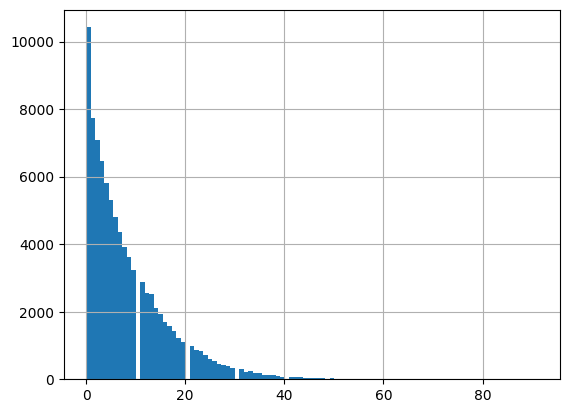

In [8]:
adata_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

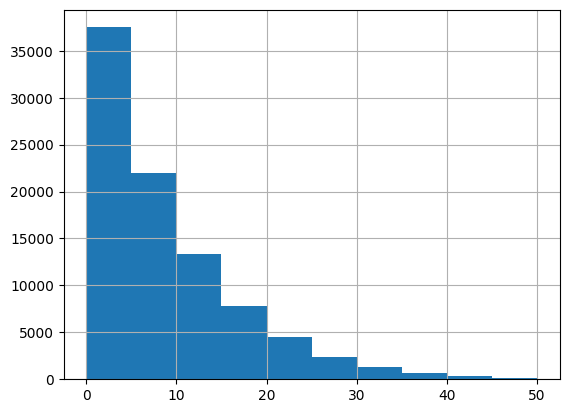

In [9]:
# in range 0-50
adata_ini.obs['transcript_counts'].hist(range=(0,50))

In [10]:
print(f"Number of cells with less than 20 transcripts: {(adata_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_ini.obs['transcript_counts']<20).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_ini.obs['transcript_counts']<15).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_ini.obs['transcript_counts']<10).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_ini.obs)}")

Number of cells with less than 20 transcripts: 80624
Percentage of cells with less than 20 transcripts: 89.48%
-----
Number of cells with less than 15 transcripts: 72778
Percentage of cells with less than 15 transcripts: 80.77%
-----
Number of cells with less than 10 transcripts: 59466
Percentage of cells with less than 10 transcripts: 66.0%
-----
Number total of cells: 90106


In [11]:
adata =  adata_ini[adata_ini.obs['transcript_counts']>10].copy()
print(len(adata.obs))

27397


In [12]:
# Save the raw data
adata.layers['count'] = adata.X.copy()

In [13]:
# Normalize
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.layers['log_norm'] = adata.X.copy()

In [14]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata, max_value=10)

## 3. Principal component analysis

In [15]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


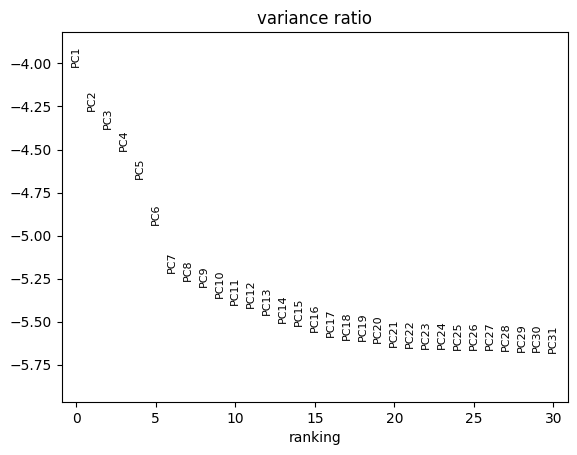

In [16]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata, log=True)

In [17]:
adata

AnnData object with n_obs × n_vars = 27397 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts'
    var: 'mean', 'std'
    uns: 'sopa_attrs', 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'tangram_pred', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [18]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [19]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_74026/2486232371.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


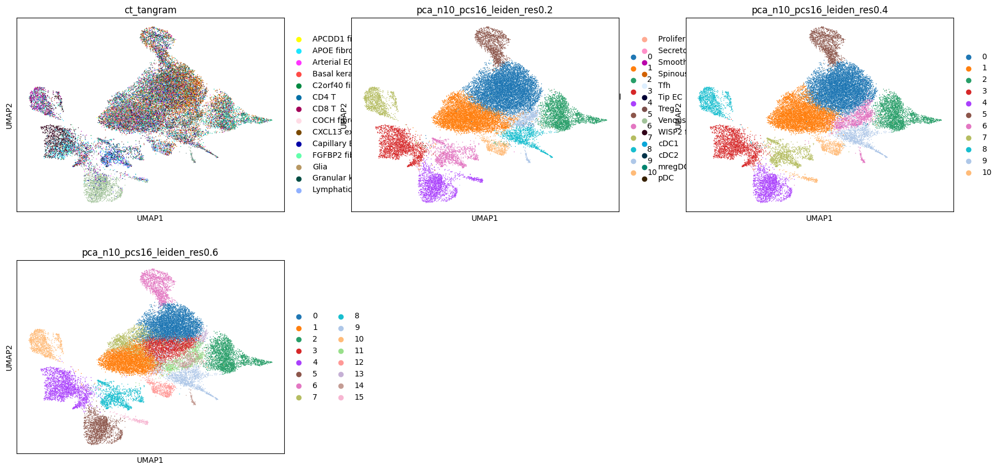

In [20]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16',
           color=['ct_tangram', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3)

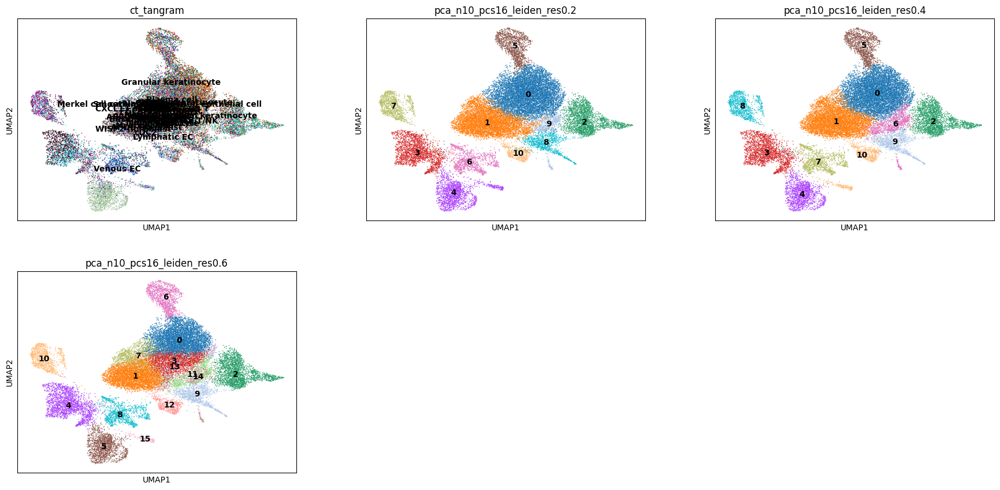

In [21]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16',
           color=['ct_tangram', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

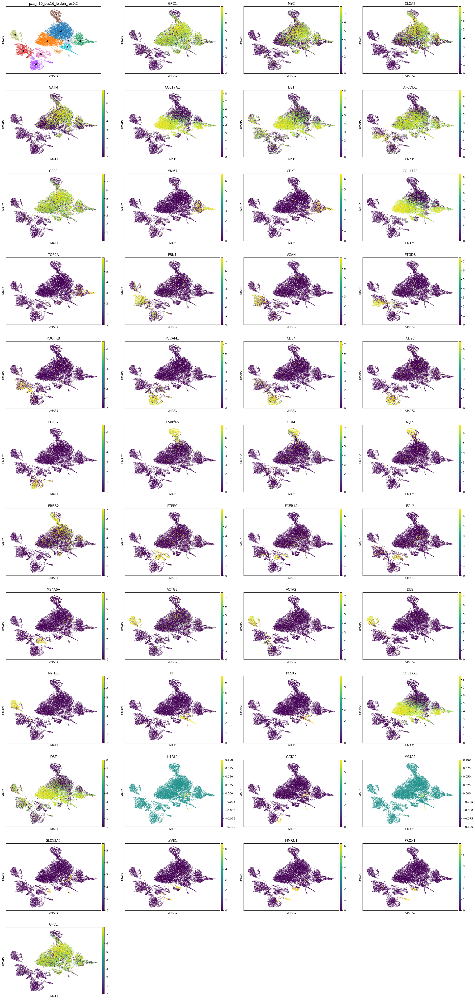

In [22]:
clustering_label = 'pca_n10_pcs16_leiden_res0.2'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

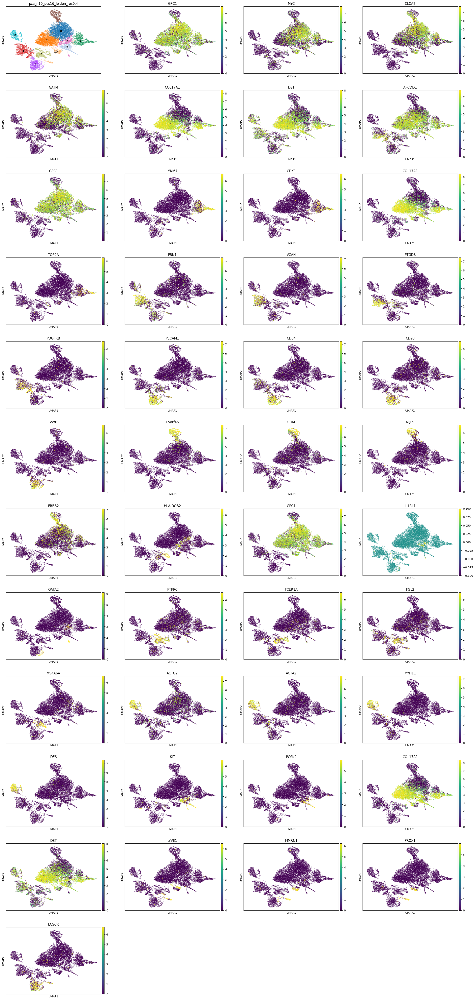

In [23]:
clustering_label = 'pca_n10_pcs16_leiden_res0.4'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [24]:
# Number of clusters
adata.obs['pca_n10_pcs16_leiden_res0.2'].unique()

['0', '2', '1', '10', '5', ..., '9', '6', '3', '4', '7']
Length: 11
Categories (11, object): ['0', '1', '2', '3', ..., '7', '8', '9', '10']

In [25]:
# Refine resolution
adata.obs['refine_res'] = 'att'

adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['0']), 'refine_res'] = '0'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['1']), 'refine_res'] = '1'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['2']), 'refine_res'] = '2'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['3']), 'refine_res'] = '3'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['4']), 'refine_res'] = '4'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['5']), 'refine_res'] = '5'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['6']), 'refine_res'] = '6'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['7']), 'refine_res'] = '7'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['8']), 'refine_res'] = '8'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['9']), 'refine_res'] = '9'
adata.obs.loc[adata.obs['pca_n10_pcs16_leiden_res0.2'].isin(['10']), 'refine_res'] = '10'

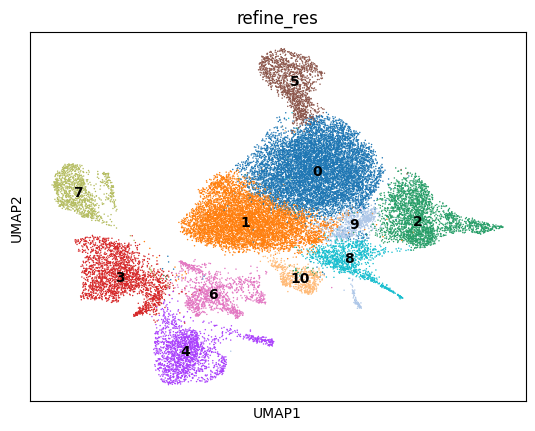

In [26]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [27]:
clustering_label = 'refine_res'

In [28]:
def get_top_tangram_labels_for_clustering(adata, clustering_key, top_n=3):

    grouped = adata.obs.groupby(clustering_key)
    results = []
    
    for cluster, group in grouped:
        
        label_counts = Counter(group['ct_tangram'])
        total_cells = len(group)
        label_percentages = [(label, round(count / total_cells * 100)) for label, count in label_counts.items()]
        top_labels = sorted(label_percentages, key=lambda x: x[1], reverse=True)[:top_n]
        
        for label, percentage in top_labels:
            results.append({
                'Cluster': cluster,
                'Label': label,
                'Percentage': percentage
            })
    
    cluster_df = pd.DataFrame(results)
    
    return cluster_df

top_tangram = get_top_tangram_labels_for_clustering(adata, clustering_label, top_n=7)

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_74026/3112203278.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = adata.obs.groupby(clustering_key)


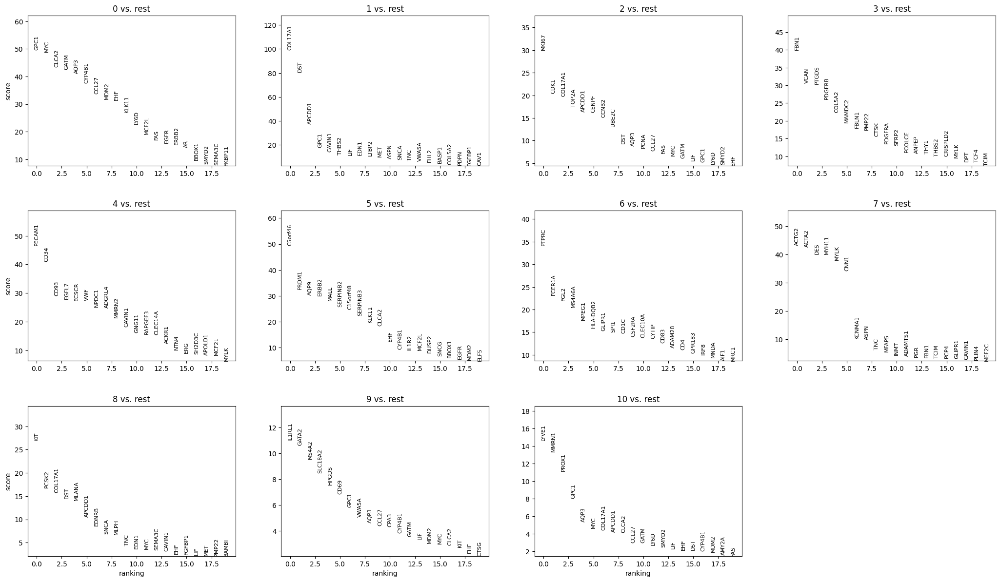

In [29]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [30]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:5, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [31]:
adata.obs['label1'] = 'att'
adata.obs['label2'] = 'att'
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

### 5.1. Cluster 0

In [32]:
cluster_id = '0'

In [33]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
0,0,Spinous keratinocyte,27
1,0,Granular keratinocyte,6
2,0,WISP2 fibroblast,6
3,0,Venous EC,5
4,0,APOE fibroblast,5
5,0,Proliferation T/NK,4
6,0,Capillary EC,4


In [34]:
top_ranked_genes[cluster_id]

0     GPC1
1      MYC
2    CLCA2
3     GATM
4     AQP3
Name: 0, dtype: object

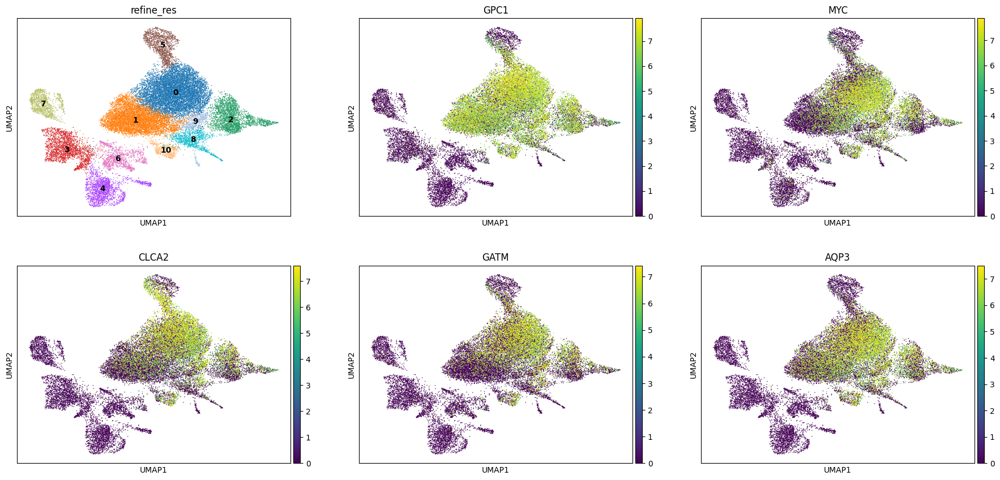

In [35]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [36]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 8412
Percentage of cells in cluster 0: 30.7


In [37]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Keratinocyte'

### 5.2. Cluster 1

In [38]:
cluster_id = '1'

In [39]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
7,1,Myofibroblast,9
8,1,WISP2 fibroblast,8
9,1,Spinous keratinocyte,8
10,1,APOE fibroblast,7
11,1,Venous EC,7
12,1,Basal keratinocyte,7
13,1,Proliferation T/NK,6


In [40]:
top_ranked_genes[cluster_id]

0    COL17A1
1        DST
2     APCDD1
3       GPC1
4     CAVIN1
Name: 1, dtype: object

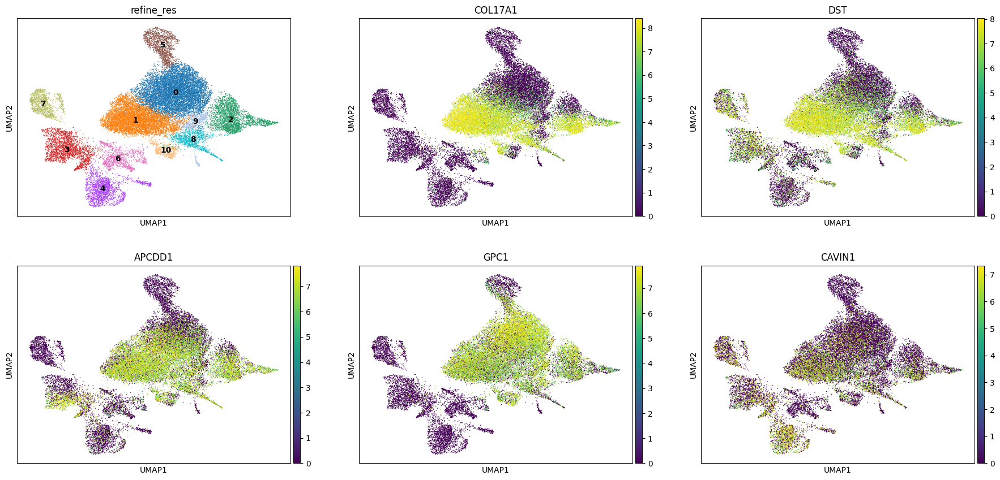

In [41]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [42]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 6268
Percentage of cells in cluster 1: 22.9


In [43]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Basal_keatinocyte'

### 5.3. Cluster 2

In [44]:
cluster_id = '2'

In [45]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
14,2,Proliferation T/NK,26
15,2,Spinous keratinocyte,15
16,2,WISP2 fibroblast,7
17,2,Venous EC,7
18,2,Proliferation keratinocyte,4
19,2,APOE fibroblast,4
20,2,Myofibroblast,4


In [46]:
top_ranked_genes[cluster_id]

0      MKI67
1       CDK1
2    COL17A1
3      TOP2A
4     APCDD1
Name: 2, dtype: object

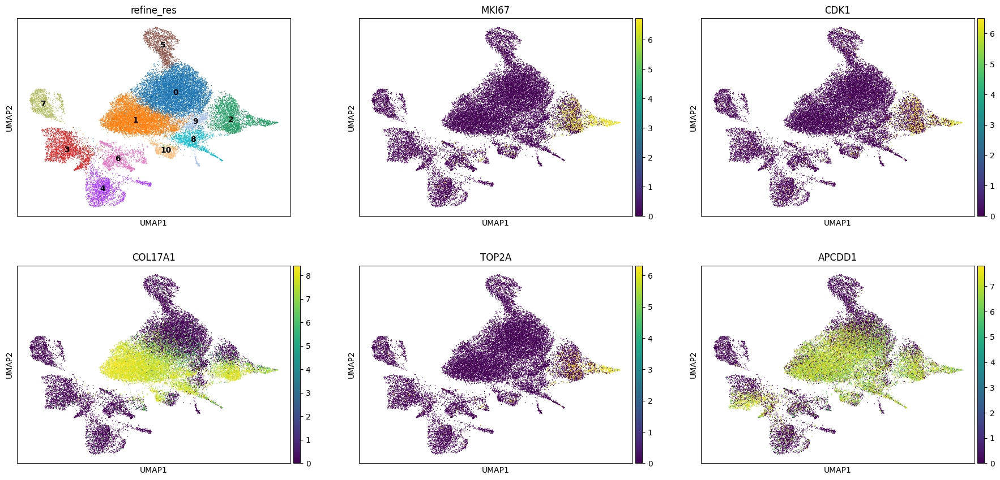

In [47]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [48]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 2537
Percentage of cells in cluster 2: 9.3


In [49]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Proliferating_basal_keratinocyte'

### 5.4. Cluster 3

In [50]:
cluster_id = '3'

In [51]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
21,3,WISP2 fibroblast,41
22,3,APOE fibroblast,20
23,3,Venous EC,8
24,3,Myofibroblast,7
25,3,Pericyte,5
26,3,Proliferation T/NK,4
27,3,Capillary EC,3


In [52]:
top_ranked_genes[cluster_id]

0      FBN1
1      VCAN
2     PTGDS
3    PDGFRB
4    COL5A2
Name: 3, dtype: object

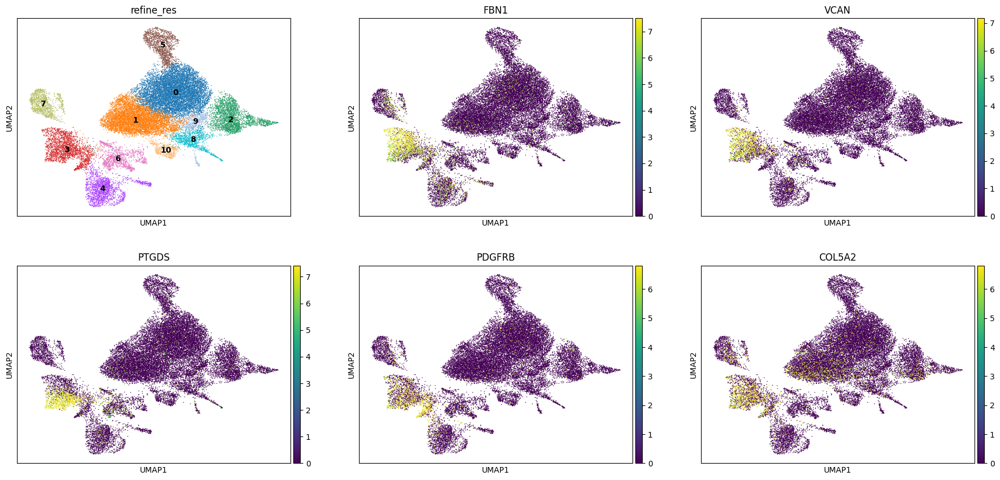

In [53]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [54]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 2184
Percentage of cells in cluster 3: 8.0


In [55]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.5. Cluster 4

In [56]:
cluster_id = '4'

In [57]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
28,4,Venous EC,84
29,4,Capillary EC,5
30,4,Lymphatic EC,3
31,4,Arterial EC,2
32,4,Proliferation T/NK,1
33,4,APOE fibroblast,1
34,4,Myofibroblast,1


In [58]:
top_ranked_genes[cluster_id]

0    PECAM1
1      CD34
2      CD93
3     EGFL7
4     ECSCR
Name: 4, dtype: object

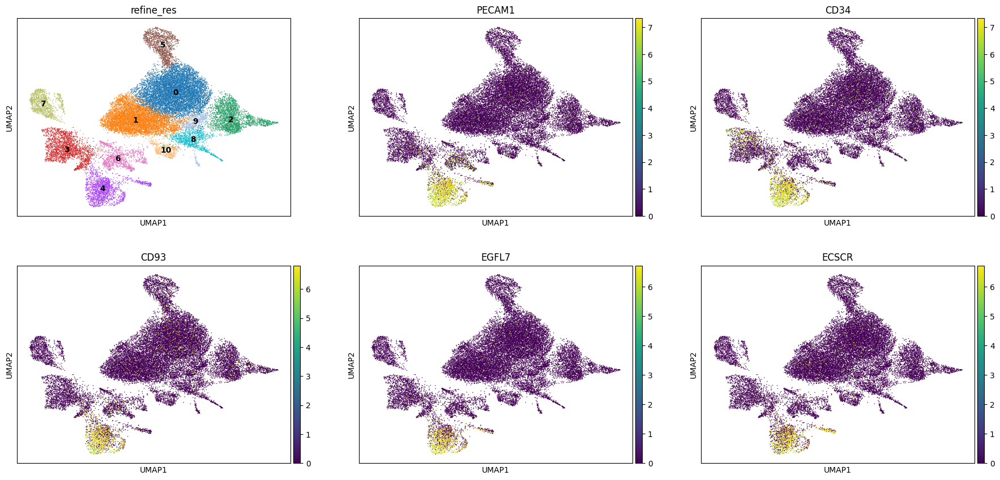

In [59]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [60]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 1827
Percentage of cells in cluster 4: 6.7


In [61]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.6. Cluster 5

In [62]:
cluster_id = '5'

In [63]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
35,5,Spinous keratinocyte,22
36,5,Granular keratinocyte,21
37,5,Smooth muscle cell,8
38,5,Venous EC,7
39,5,Proliferation T/NK,5
40,5,Capillary EC,4
41,5,WISP2 fibroblast,3


In [64]:
top_ranked_genes[cluster_id]

0    C5orf46
1      PRDM1
2       AQP9
3      ERBB2
4       MALL
Name: 5, dtype: object

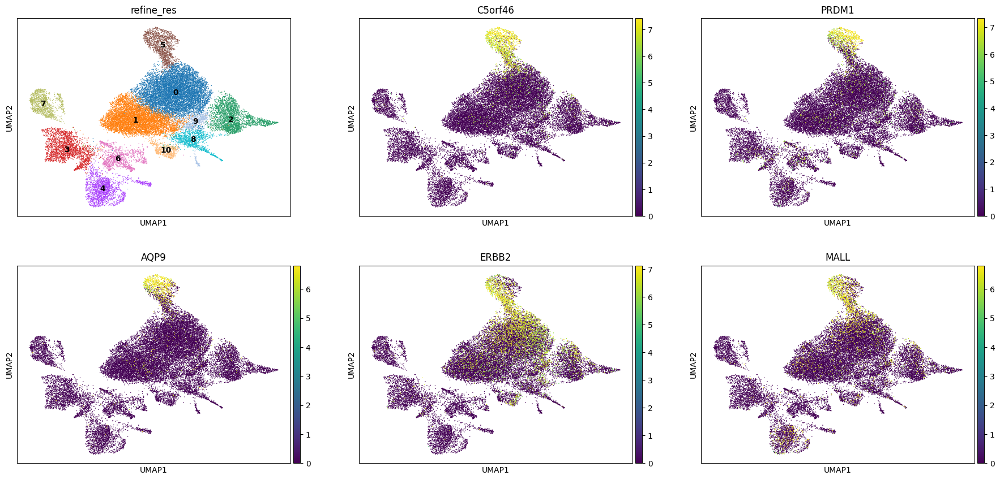

In [65]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [66]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 1453
Percentage of cells in cluster 5: 5.3


In [67]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Keratinocyte'

### 5.7. Cluster 6

In [68]:
cluster_id = '6'

In [69]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
42,6,Monocyte,22
43,6,cDC2,15
44,6,Proliferation T/NK,9
45,6,Mast cell,7
46,6,WISP2 fibroblast,5
47,6,APOE fibroblast,4
48,6,COCH fibroblast,4


In [70]:
top_ranked_genes[cluster_id]

0     PTPRC
1    FCER1A
2      FGL2
3    MS4A6A
4     MPEG1
Name: 6, dtype: object

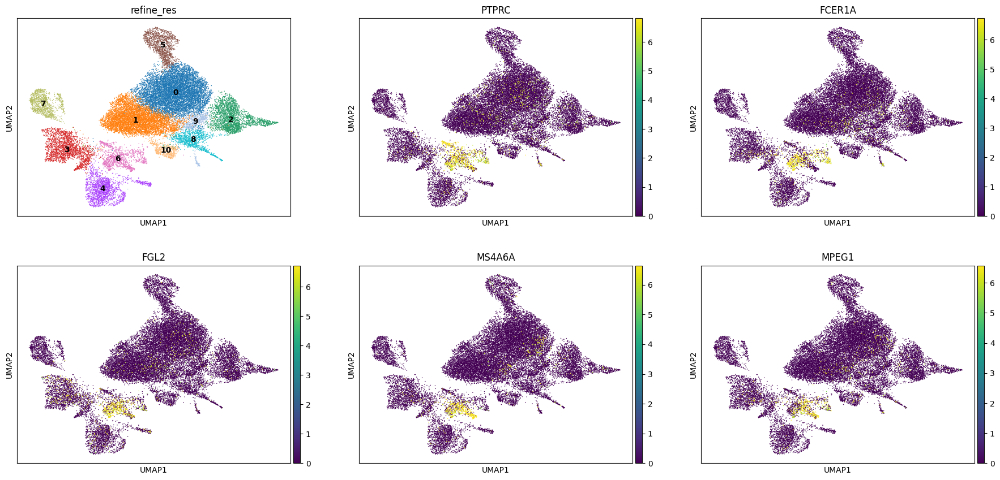

In [71]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [72]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 1191
Percentage of cells in cluster 6: 4.3


In [73]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Macrophage/DC'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Macrophage/DC'

### 5.8. Cluster 7

In [74]:
cluster_id = '7'

In [75]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
49,7,Smooth muscle cell,26
50,7,Myofibroblast,13
51,7,WISP2 fibroblast,12
52,7,APOE fibroblast,7
53,7,Proliferation T/NK,6
54,7,Capillary EC,5
55,7,Mast cell,5


In [76]:
top_ranked_genes[cluster_id]

0    ACTG2
1    ACTA2
2      DES
3    MYH11
4     MYLK
Name: 7, dtype: object

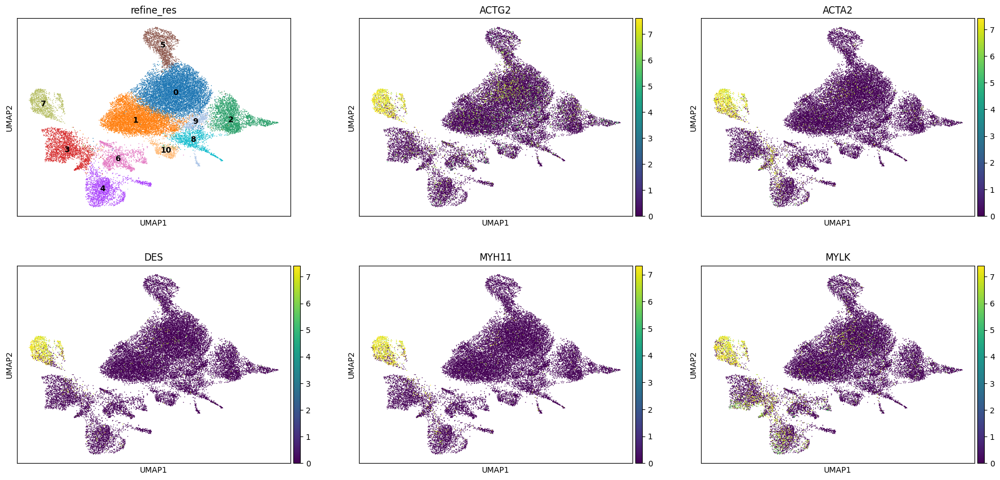

In [77]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [78]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 1126
Percentage of cells in cluster 7: 4.1


In [79]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Smooth_muscle'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Smooth_muscle'

### 5.9. Cluster 8

In [80]:
cluster_id = '8'

In [81]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
56,8,Mast cell,11
57,8,Spinous keratinocyte,10
58,8,Venous EC,8
59,8,WISP2 fibroblast,8
60,8,APOE fibroblast,7
61,8,Proliferation T/NK,7
62,8,Myofibroblast,7


In [82]:
top_ranked_genes[cluster_id]

0        KIT
1      PCSK2
2    COL17A1
3        DST
4      MLANA
Name: 8, dtype: object

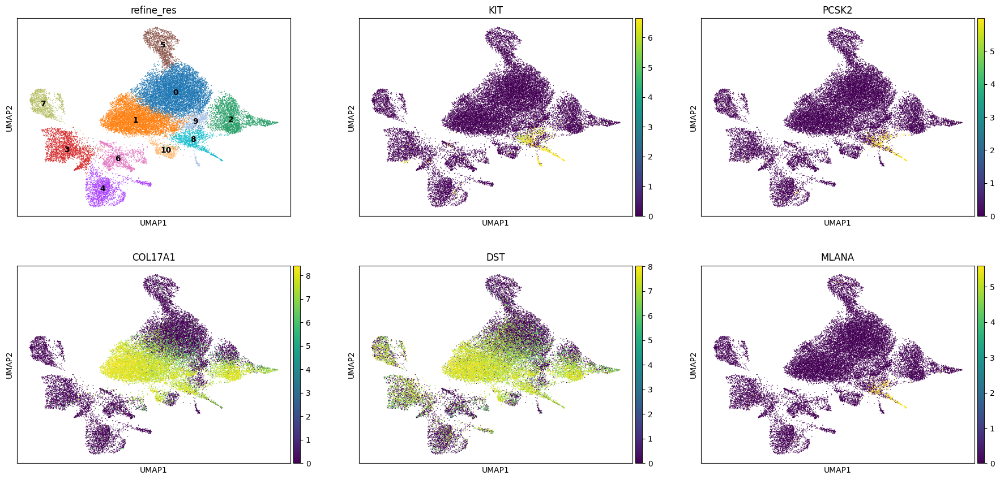

In [83]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [84]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 1067
Percentage of cells in cluster 8: 3.9


In [85]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Melanocyte'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Melanocyte'

### 5.10. Cluster 9

In [86]:
cluster_id = '9'

In [87]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
63,9,Mast cell,34
64,9,Spinous keratinocyte,18
65,9,Venous EC,9
66,9,Proliferation T/NK,9
67,9,Myofibroblast,5
68,9,WISP2 fibroblast,5
69,9,APOE fibroblast,3


In [88]:
top_ranked_genes[cluster_id]

0     IL1RL1
1      GATA2
2      MS4A2
3    SLC18A2
4      HPGDS
Name: 9, dtype: object

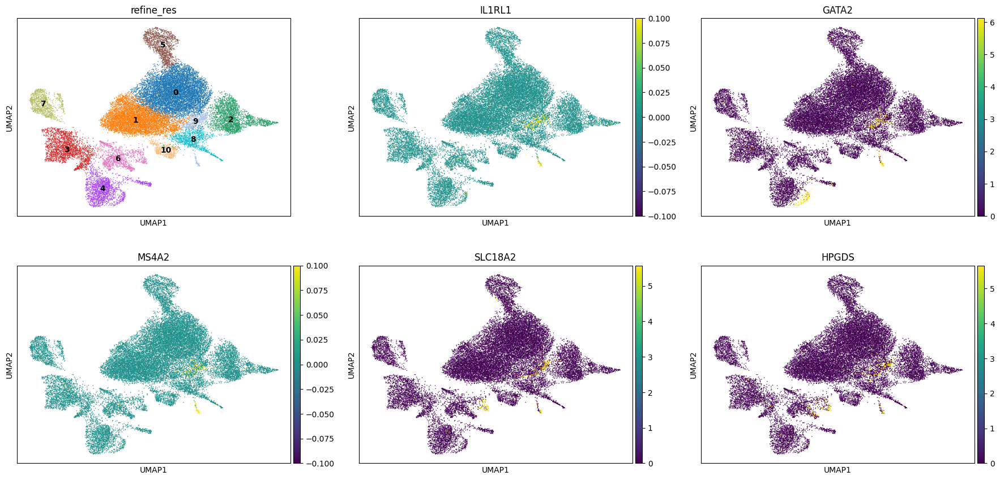

In [89]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [90]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 782
Percentage of cells in cluster 9: 2.9


In [91]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

### 5.11. Cluster 10

In [92]:
cluster_id = '10'

In [93]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
70,10,Lymphatic EC,24
71,10,Spinous keratinocyte,19
72,10,Proliferation T/NK,7
73,10,WISP2 fibroblast,7
74,10,Myofibroblast,6
75,10,APOE fibroblast,6
76,10,Venous EC,6


In [94]:
top_ranked_genes[cluster_id]

0    LYVE1
1    MMRN1
2    PROX1
3     GPC1
4     AQP3
Name: 10, dtype: object

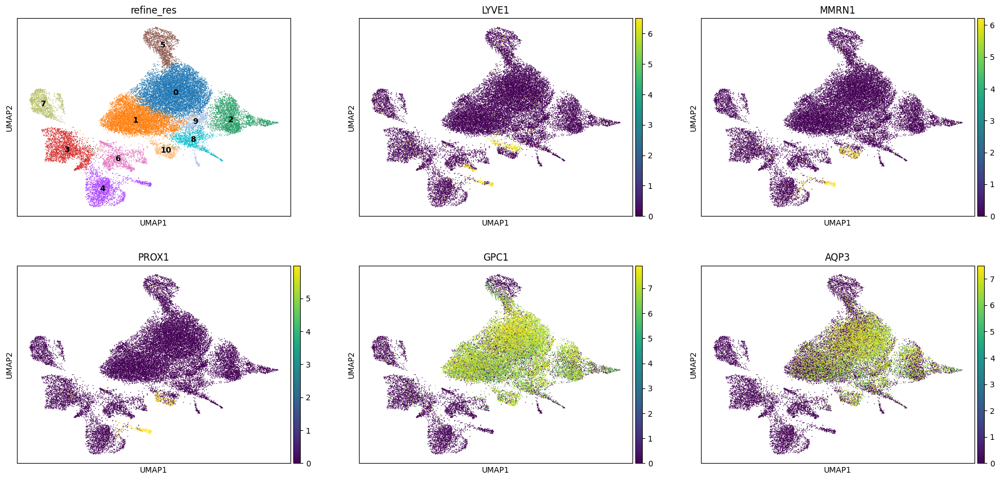

In [95]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [96]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 550
Percentage of cells in cluster 10: 2.0


In [97]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

## 6. Cancer cells

In [98]:
adata.obs['label1'].unique()

array(['Epithelial', 'Endothelial', 'Melanocyte', 'Mast', 'Macrophage/DC',
       'Fibroblast', 'Smooth_muscle'], dtype=object)

In [99]:
adata.obs['label2'].unique()

array(['Keratinocyte', 'Proliferating_basal_keratinocyte',
       'Basal_keatinocyte', 'Endothelial', 'Melanocyte', 'Mast',
       'Macrophage/DC', 'Fibroblast', 'Smooth_muscle'], dtype=object)

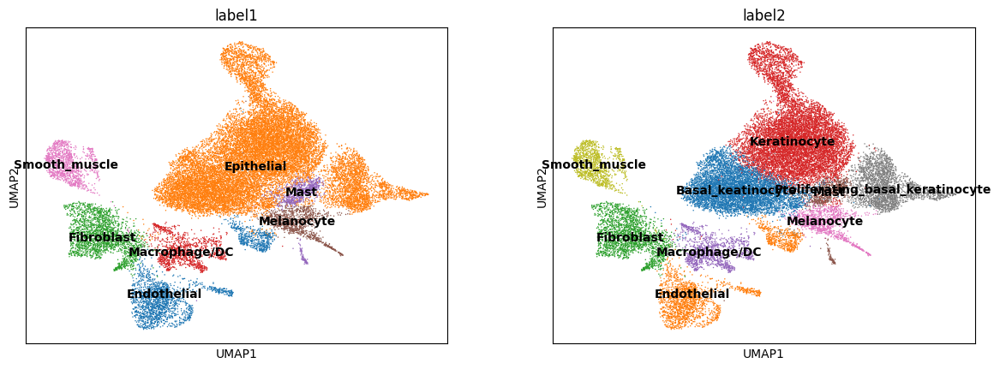

In [100]:
sc.pl.umap(adata, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [101]:
# Patient is not cancerous
adata.obs['label3'] = 'normal_cell'

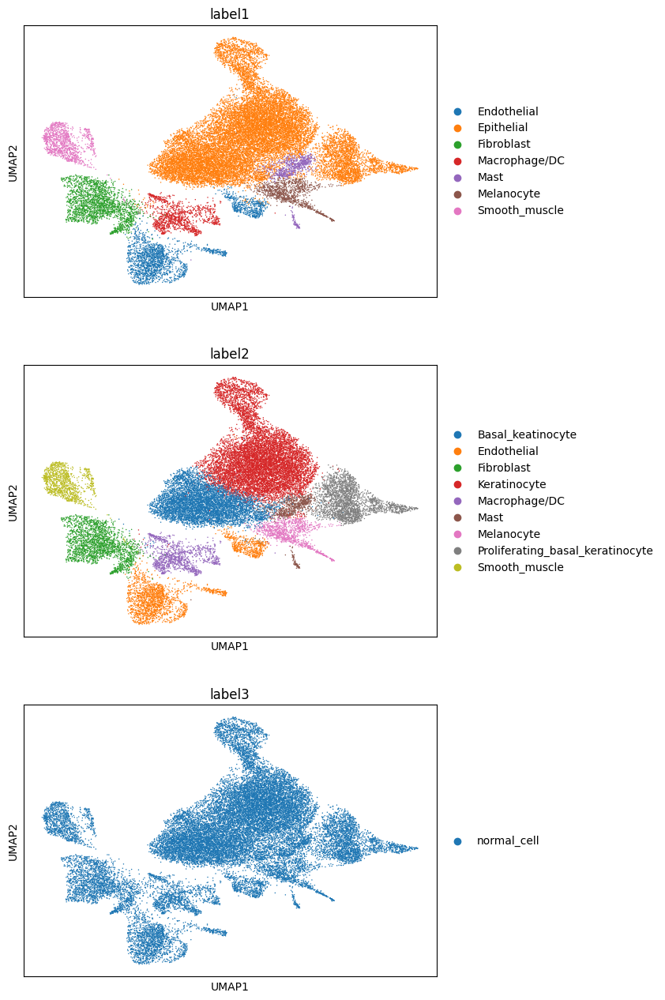

In [102]:
sc.pl.umap(adata, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [103]:
adata.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,39.940594,cDC2,16,0,0,0,0,Epithelial,Keratinocyte,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,68.861777,Treg,14,2,2,2,2,Epithelial,Proliferating_basal_keratinocyte,normal_cell
aaaaaaaf-1,nucleus_boundaries,morpho,aaaaaaaf-1,48.522513,Venous EC,13,0,0,3,0,Epithelial,Keratinocyte,normal_cell
aaaaaaag-1,nucleus_boundaries,morpho,aaaaaaag-1,27.160800,Granular keratinocyte,13,0,0,0,0,Epithelial,Keratinocyte,normal_cell
aaaaaaah-1,nucleus_boundaries,morpho,aaaaaaah-1,67.373418,Myofibroblast,34,1,9,1,1,Epithelial,Basal_keatinocyte,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaabfppa-1,nucleus_boundaries,morpho,aaabfppa-1,28.537759,FGFBP2 fibroblast,16,0,0,0,0,Epithelial,Keratinocyte,normal_cell
aaabfppb-1,nucleus_boundaries,morpho,aaabfppb-1,27.004104,Tip EC,14,1,1,1,1,Epithelial,Basal_keatinocyte,normal_cell
aaabfppc-1,nucleus_boundaries,morpho,aaabfppc-1,41.884627,WISP2 fibroblast,20,0,6,11,0,Epithelial,Keratinocyte,normal_cell
aaabfppd-1,nucleus_boundaries,morpho,aaabfppd-1,26.891084,Venous EC,13,0,0,0,0,Epithelial,Keratinocyte,normal_cell


In [104]:
adata.write_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
# adata = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")